<a href="https://colab.research.google.com/github/AndSiq97/COVID-19-Healthy-Diet/blob/master/Fat_Supply_Quantity_COVID_19_Health_Diet_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib 
import seaborn as sns
import os
%matplotlib inline
import matplotlib.style as style

In [2]:
# Uncomment this cell, Run this, comment cell, restart runtime and run everything else
# !pip install --upgrade matplotlib

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/My Drive/Kaggle"
# /content/gdrive/My Drive/Kaggle is the path where kaggle.json is present in the Google Drive

#changing the working directory
%cd /content/gdrive/My Drive/Kaggle
#Check the present working directory using pwd command

Mounted at /content/gdrive
/content/gdrive/My Drive/Kaggle


Load Datasets

In [4]:
# Reading some csv files
fat_supply_quantity_data = pd.read_csv("/content/gdrive/MyDrive/Fat_Supply_Quantity_Data.csv")
supply_food_descriptions_data = pd.read_csv("/content/gdrive/MyDrive/Supply_Food_Data_Descriptions.csv")

Food Supply Descriptions Data

In [5]:
# Checking first 5 rows of Supply Food Descriptions dataframe
supply_food_descriptions_data.head()

,Categories,Items
0,Alcoholic Beverages,"Alcohol, Non-Food; Beer; Beverages, Alcoholic;..."
1,Animal fats,"Butter, Ghee; Cream; Fats, Animals, Raw; Fish,..."
2,Animal Products,"Aquatic Animals, Others; Aquatic Plants; Bovin..."
3,"Aquatic Products, Other","Aquatic Animals, Others; Aquatic Plants; Meat,..."
4,Cereals - Excluding Beer,"Barley and products; Cereals, Other; Maize and..."


Fat Supply Quantity Data

In [6]:
# Checking first 5 rows of Fat Supply Quantity dataframe
fat_supply_quantity_data.head()

,Country,Alcoholic Beverages,Animal Products,Animal fats,"Aquatic Products, Other",Cereals - Excluding Beer,Eggs,"Fish, Seafood",Fruits - Excluding Wine,Meat,Miscellaneous,Milk - Excluding Butter,Offals,Oilcrops,Pulses,Spices,Starchy Roots,Stimulants,Sugar Crops,Sugar & Sweeteners,Treenuts,Vegetal Products,Vegetable Oils,Vegetables,Obesity,Undernourished,Confirmed,Deaths,Recovered,Active,Population,Unit (all except Population)
0,Afghanistan,0.0,21.6397,6.2224,0.0,8.0353,0.6859,0.0327,0.4246,6.1244,0.0163,8.2803,0.3103,1.0452,0.1960,0.2776,0.0490,0.0980,0.0,0.0,0.7513,28.3684,17.0831,0.3593,4.5,29.8,0.005707,0.000168,0.000683,0.004855,38042000.0,%
1,Albania,0.0,32.0002,3.4172,0.0,2.6734,1.6448,0.1445,0.6418,8.7428,0.0170,17.7576,0.2933,3.1622,0.1148,0.0000,0.0510,0.5270,0.0,0.0,0.9181,17.9998,9.2443,0.6503,22.3,6.2,0.027047,0.001085,0.016445,0.009517,2858000.0,%
2,Algeria,0.0,14.4175,0.8972,0.0,4.2035,1.2171,0.2008,0.5772,3.8961,0.0439,8.0934,0.1067,1.1983,0.2698,0.1568,0.1129,0.2886,0.0,0.0,0.8595,35.5857,27.3606,0.5145,26.6,3.9,0.009229,0.001037,0.004099,0.004094,43406000.0,%
3,Angola,0.0,15.3041,1.3130,0.0,6.5545,0.1539,1.4155,0.3488,11.0268,0.0308,1.2309,0.1539,3.9902,0.3282,0.0103,0.7078,0.1128,0.0,0.0,0.0308,34.7010,22.4638,0.1231,6.8,25,0.000086,0.000006,0.000022,0.000057,31427000.0,%
4,Antigua and Barbuda,0.0,27.7033,4.6686,0.0,3.2153,0.3872,1.5263,1.2177,14.3202,0.0898,6.6607,0.1347,1.3579,0.0673,0.3591,0.0449,1.0549,0.0,0.0,0.2020,22.2995,14.4436,0.2469,19.1,NaN,0.024742,0.003093,0.011340,0.010309,97000.0,%


In [7]:
# Names of Columns in DataFrame
fat_supply_quantity_data.columns

Index(['Country', 'Alcoholic Beverages', 'Animal Products', 'Animal fats',
       'Aquatic Products, Other', 'Cereals - Excluding Beer', 'Eggs',
       'Fish, Seafood', 'Fruits - Excluding Wine', 'Meat', 'Miscellaneous',
       'Milk - Excluding Butter', 'Offals', 'Oilcrops', 'Pulses', 'Spices',
       'Starchy Roots', 'Stimulants', 'Sugar Crops', 'Sugar & Sweeteners',
       'Treenuts', 'Vegetal Products', 'Vegetable Oils', 'Vegetables',
       'Obesity', 'Undernourished', 'Confirmed', 'Deaths', 'Recovered',
       'Active', 'Population', 'Unit (all except Population)'],
      dtype='object')

In [8]:
# Checking size/shape of DataFrame
fat_supply_quantity_data.shape

(170, 32)

In [9]:
# Data Info
fat_supply_quantity_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170 entries, 0 to 169
Data columns (total 32 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Country                       170 non-null    object 
 1   Alcoholic Beverages           170 non-null    float64
 2   Animal Products               170 non-null    float64
 3   Animal fats                   170 non-null    float64
 4   Aquatic Products, Other       170 non-null    float64
 5   Cereals - Excluding Beer      170 non-null    float64
 6   Eggs                          170 non-null    float64
 7   Fish, Seafood                 170 non-null    float64
 8   Fruits - Excluding Wine       170 non-null    float64
 9   Meat                          170 non-null    float64
 10  Miscellaneous                 170 non-null    float64
 11  Milk - Excluding Butter       170 non-null    float64
 12  Offals                        170 non-null    float64
 13  Oilcr

In [10]:
# Weird that Undernourished Rate (as %) is not a float type so we'll change that
import re
import random

# random number for Undernourished values < 2.5 to reduce bias 
def random_number(integer):
  if integer == 2.5:
    return random.uniform(0.0, 2.5)
  return integer

fat_supply_quantity_data['Undernourished'] = fat_supply_quantity_data['Undernourished'].apply(lambda string: re.compile(r'[^\d.]+').sub('', str(string))) 
fat_supply_quantity_data['Undernourished'] = pd.to_numeric(fat_supply_quantity_data['Undernourished'], errors='coerce')
fat_supply_quantity_data['Undernourished'] = fat_supply_quantity_data['Undernourished'].apply(lambda integer: random_number(integer)) 

In [11]:
# Basic statistics to describe DataFrame
fat_supply_quantity_data.describe()

,Alcoholic Beverages,Animal Products,Animal fats,"Aquatic Products, Other",Cereals - Excluding Beer,Eggs,"Fish, Seafood",Fruits - Excluding Wine,Meat,Miscellaneous,Milk - Excluding Butter,Offals,Oilcrops,Pulses,Spices,Starchy Roots,Stimulants,Sugar Crops,Sugar & Sweeteners,Treenuts,Vegetal Products,Vegetable Oils,Vegetables,Obesity,Undernourished,Confirmed,Deaths,Recovered,Active,Population
count,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,167.000000,163.000000,160.000000,160.000000,160.000000,160.000000,1.700000e+02
mean,0.001035,20.695714,4.138451,0.000450,4.376548,0.953890,0.850437,0.542117,9.494279,0.056589,5.109061,0.148904,3.327555,0.261032,0.281251,0.228279,0.644379,0.004108,0.001407,0.698955,29.304396,18.571657,0.309512,18.707784,10.880231,0.058884,0.003343,0.025432,0.030158,4.408395e+07
std,0.009569,8.002713,3.287462,0.004039,3.183815,0.643957,0.924103,0.838286,4.666762,0.072633,3.331668,0.113060,4.663950,0.368139,0.448822,0.364437,0.700193,0.022460,0.008384,0.814828,8.002369,6.766615,0.211766,9.633557,12.169611,0.104288,0.009448,0.067907,0.052592,1.556265e+08
min,0.000000,5.018200,0.026200,0.000000,0.990800,0.058000,0.017400,0.037300,0.906100,0.000000,0.177900,0.000000,0.064000,0.000000,0.000000,0.012400,0.000000,0.000000,0.000000,0.000000,13.098200,4.954900,0.026300,2.100000,0.003989,0.000021,0.000000,0.000000,0.000010,5.300000e+04
25%,0.000000,14.885800,1.674225,0.000000,1.970150,0.411350,0.330975,0.239500,6.263575,0.010125,2.219100,0.076625,0.847225,0.043250,0.037725,0.047875,0.113700,0.000000,0.000000,0.137350,23.133050,13.812825,0.173675,8.500000,2.229532,0.003070,0.000055,0.000726,0.001078,2.822750e+06
50%,0.000000,20.943050,3.312350,0.000000,3.306750,0.898300,0.572700,0.361400,9.259000,0.031650,4.947600,0.123550,1.688900,0.137100,0.102300,0.086250,0.390500,0.000000,0.000000,0.452400,29.060600,18.192550,0.247450,21.200000,6.800000,0.013152,0.000336,0.003517,0.006543,1.014600e+07
75%,0.000000,26.866950,6.227575,0.000000,5.587600,1.276900,1.111625,0.577800,11.750450,0.076325,7.322750,0.188875,3.511200,0.341575,0.344075,0.212425,0.915150,0.000000,0.000000,0.914025,35.117250,23.597300,0.362925,25.700000,14.600000,0.068110,0.001683,0.018089,0.032337,3.169250e+07
max,0.097600,36.901800,14.937300,0.051100,18.376300,3.275600,8.406800,9.672700,26.429200,0.456100,17.757600,0.726800,28.563900,2.690900,2.685100,2.177800,3.383800,0.189200,0.081300,4.975600,44.981800,36.418600,1.153800,45.600000,59.600000,0.610323,0.066277,0.518226,0.266797,1.398030e+09


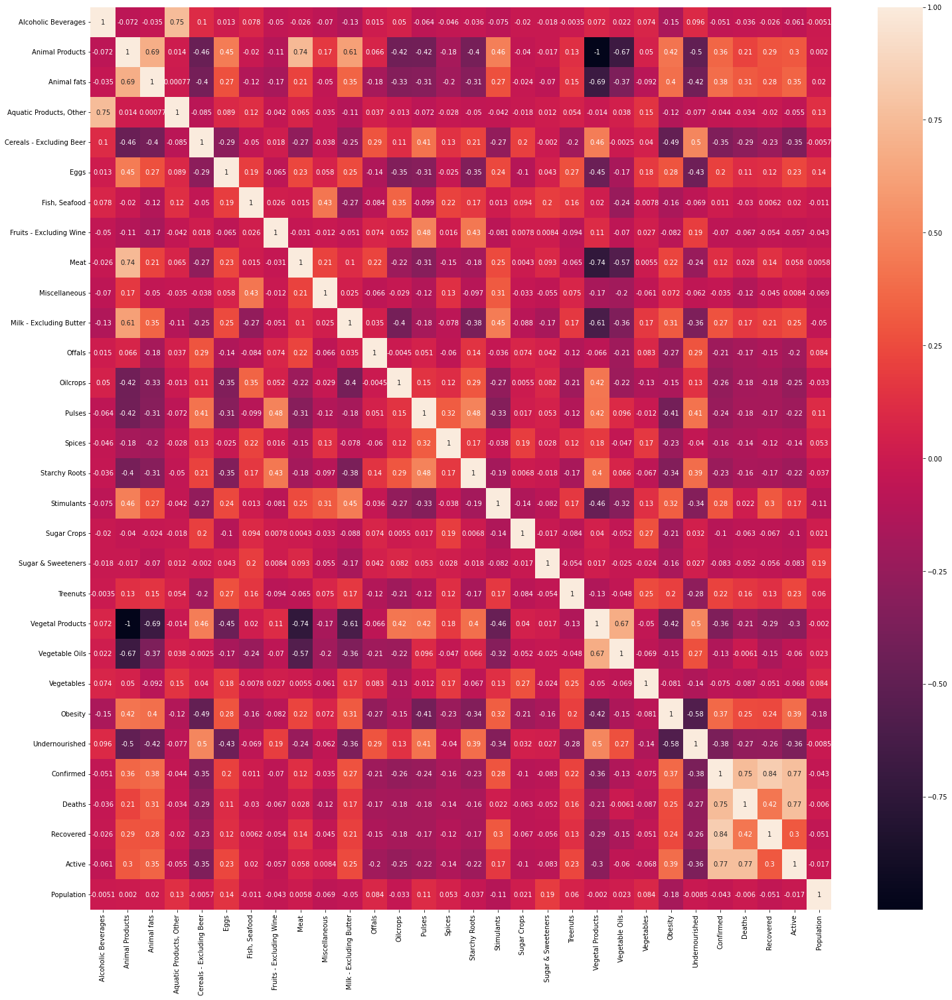

In [12]:
# Correlation Matrix (Works Only for Regression Variables)
fig, ax = plt.subplots(figsize=(25,25)) 
corrMatrix = fat_supply_quantity_data.corr()
sns.heatmap(corrMatrix, annot=True, ax=ax)
plt.show()

In [13]:
# List of ALL Health Diet Intakes 
health_diet_intakes = ['Alcoholic Beverages', 'Animal Products', 'Animal fats', 'Aquatic Products, Other', 'Cereals - Excluding Beer', 'Eggs', 'Fish, Seafood', 'Fruits - Excluding Wine', 
                       'Meat', 'Miscellaneous', 'Milk - Excluding Butter', 'Offals', 'Oilcrops', 'Pulses', 'Spices', 'Starchy Roots', 'Stimulants', 'Sugar Crops', 'Sugar & Sweeteners',
                       'Treenuts', 'Vegetal Products', 'Vegetable Oils', 'Vegetables']

Relationship Between ALL Health Diet Fat Intakes Percentage and Obesity Percentage

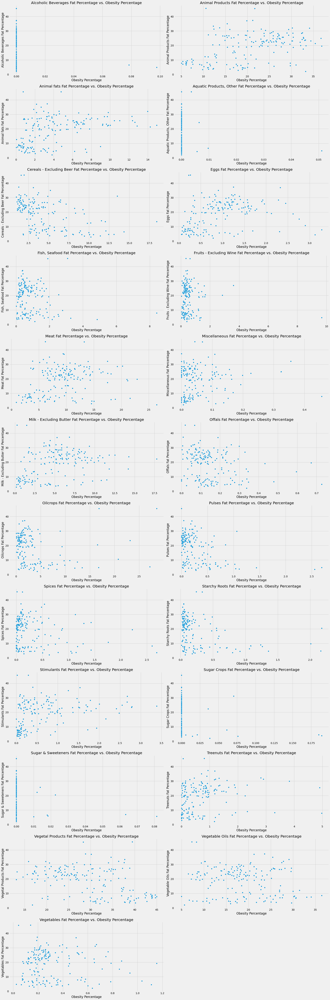

In [15]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Obesity', 
            data = fat_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Fat Percentage vs. Obesity Percentage"
  x_title = "Obesity Percentage"
  y_title = intake + " Fat Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Fat Intakes Percentage and Undernourished Percentage

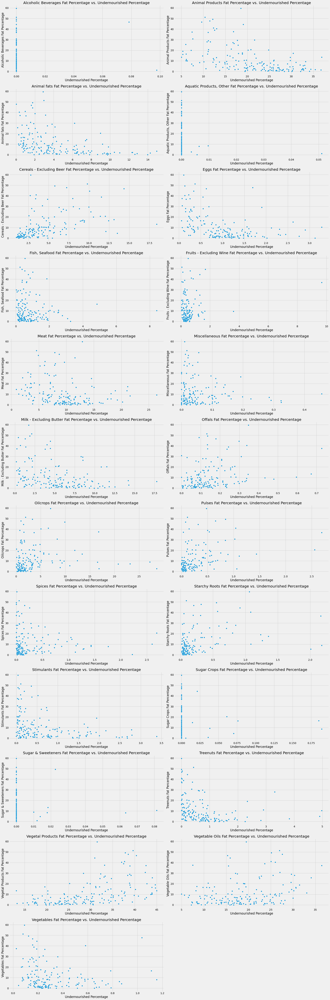

In [16]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Undernourished', 
            data = fat_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Fat Percentage vs. Undernourished Percentage"
  x_title = "Undernourished Percentage"
  y_title = intake + " Fat Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Fat Intakes Percentage and Confirmed Cases of COVID-19 Percentage

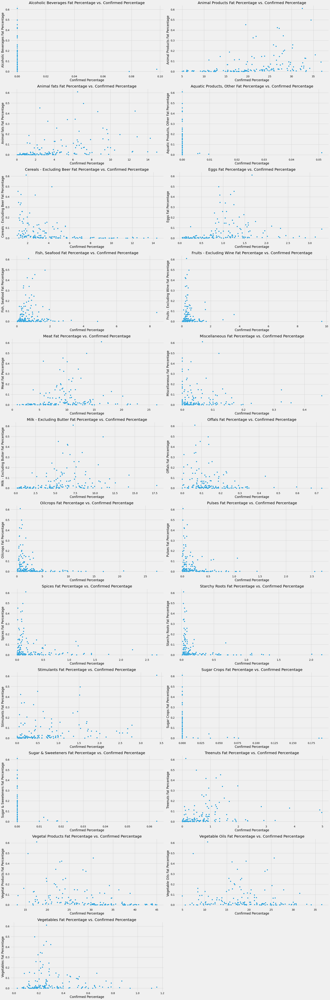

In [17]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Confirmed', 
            data = fat_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Fat Percentage vs. Confirmed Percentage"
  x_title = "Confirmed Percentage"
  y_title = intake + " Fat Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Fat Intakes Percentage and Death from COVID-19 Percentage

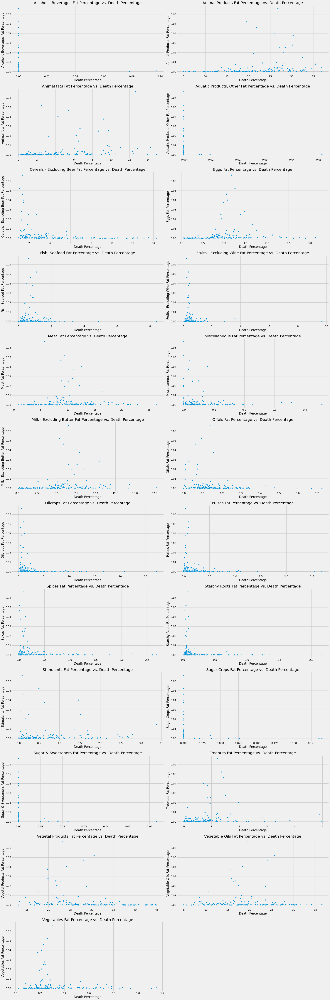

In [18]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Deaths', 
            data = fat_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Fat Percentage vs. Death Percentage"
  x_title = "Death Percentage"
  y_title = intake + " Fat Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Fat Intakes Percentage and Recovery from COVID-19 Percentage

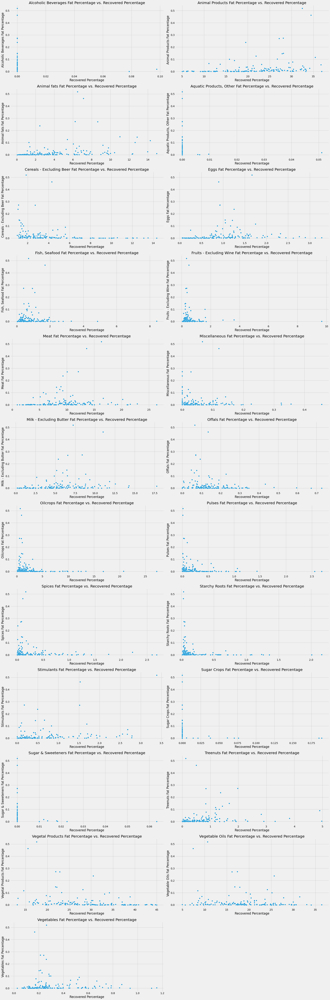

In [19]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Recovered', 
            data = fat_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Fat Percentage vs. Recovered Percentage"
  x_title = "Recovered Percentage"
  y_title = intake + " Fat Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Fat Intakes Percentage and Active Cases of COVID-19 Percentage

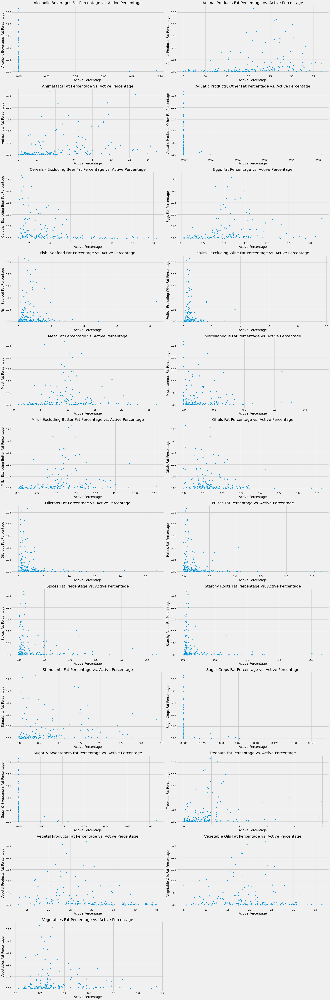

In [21]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Active', 
            data = fat_supply_quantity_data)
  style.use('fivethirtyeight')
  title = intake + " Fat Percentage vs. Active Percentage"
  x_title = "Active Percentage"
  y_title = intake + " Fat Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Obesity Percentages and ALL of Confirmed, Death, Recovered, and Active Percentages of COVID-19

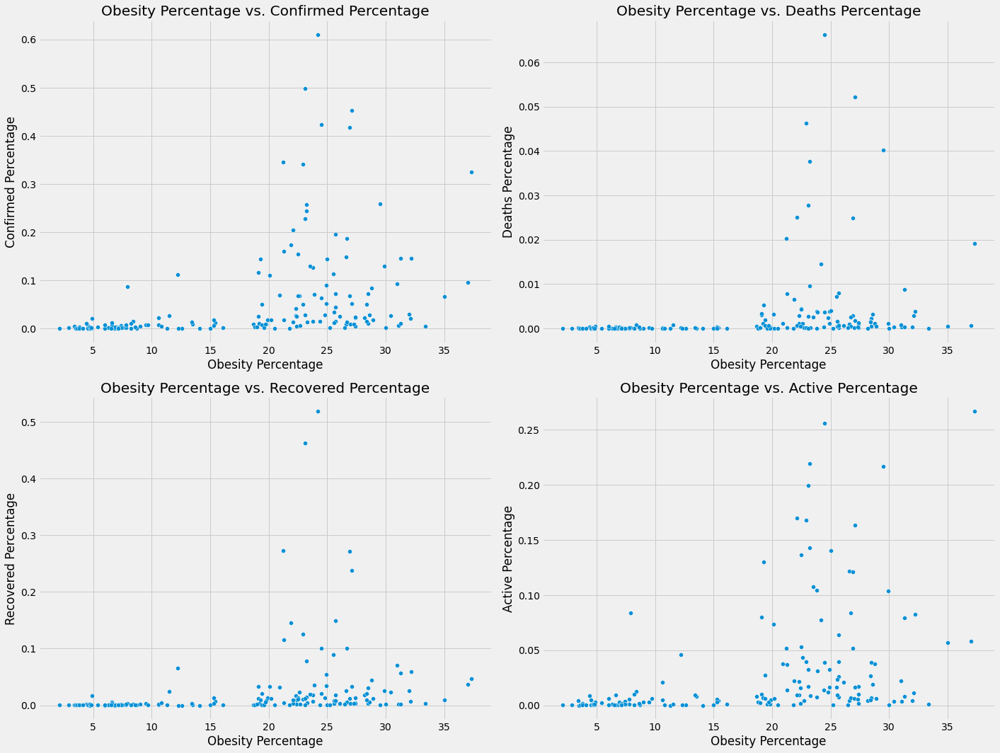

In [22]:
a = 2  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(20,15))
for target in ['Confirmed', 'Deaths', 'Recovered', 'Active']:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = 'Obesity', y = target, 
            data = fat_supply_quantity_data)
  style.use('fivethirtyeight')
  title = "Obesity Percentage vs. " + target + " Percentage"
  x_title = "Obesity Percentage"
  y_title = target + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Undernourished Percentages and ALL of Confirmed, Death, Recovered, and Active Percentages of COVID-19 

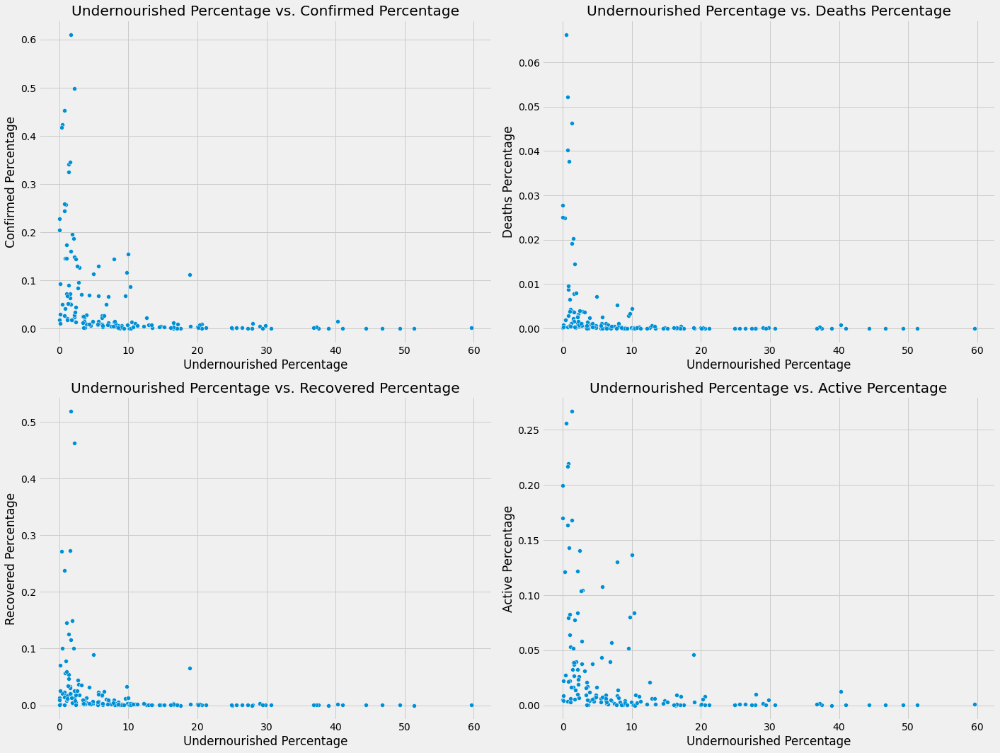

In [23]:
a = 2  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(20,15))
for target in ['Confirmed', 'Deaths', 'Recovered', 'Active']:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = 'Undernourished', y = target, 
            data = fat_supply_quantity_data)
  style.use('fivethirtyeight')
  title = "Undernourished Percentage vs. " + target + " Percentage"
  x_title = "Undernourished Percentage"
  y_title = target + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Confirmed Cases of COVID-19 Percentages Between Countries

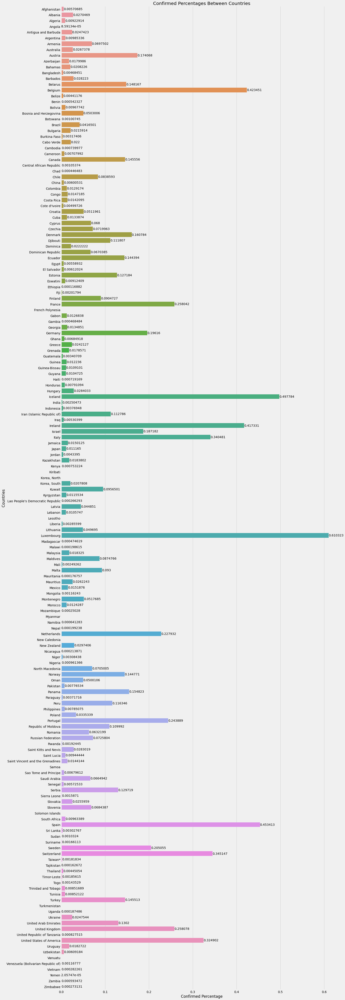

In [28]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Confirmed', y = 'Country', data = fat_supply_quantity_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Confirmed Percentages Between Countries"
plt.title(title)
plt.xlabel("Confirmed Percentage")
plt.ylabel("Countries")
plt.show()

Death from COVID-19 Percentages Between Countries

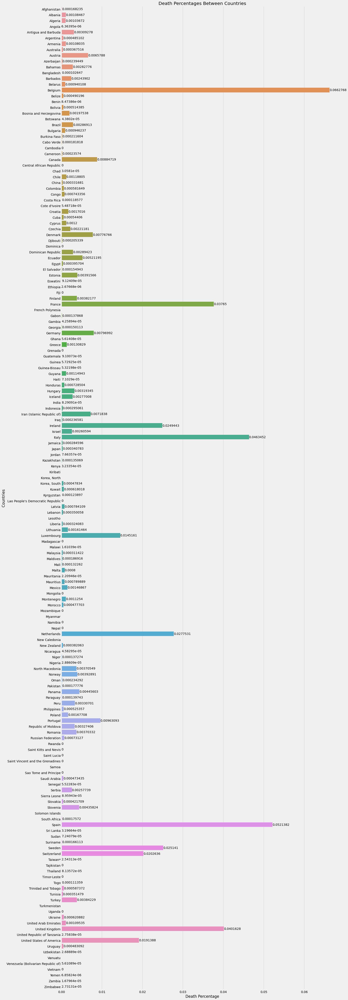

In [27]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Deaths', y = 'Country', data = fat_supply_quantity_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Death Percentages Between Countries"
plt.title(title)
plt.xlabel("Death Percentage")
plt.ylabel("Countries")
plt.show()

Recovered from COVID-19 Percentages Between Countries

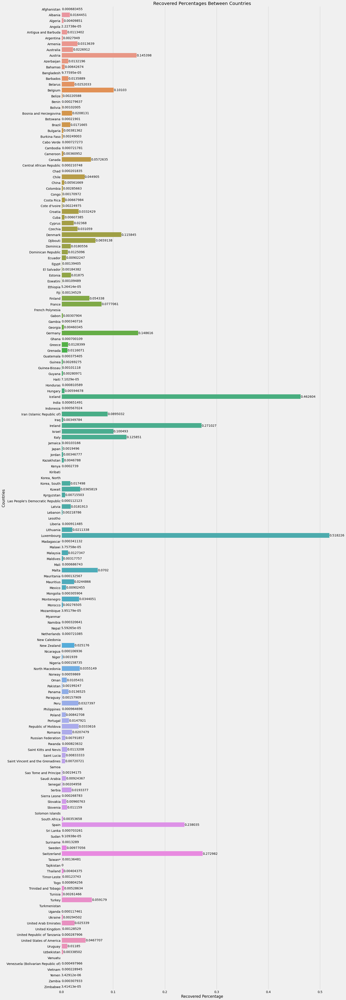

In [26]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Recovered', y = 'Country', data = fat_supply_quantity_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Recovered Percentages Between Countries"
plt.title(title)
plt.xlabel("Recovered Percentage")
plt.ylabel("Countries")
plt.show()

Active Cases of COVID-19 Percentages Between Countries

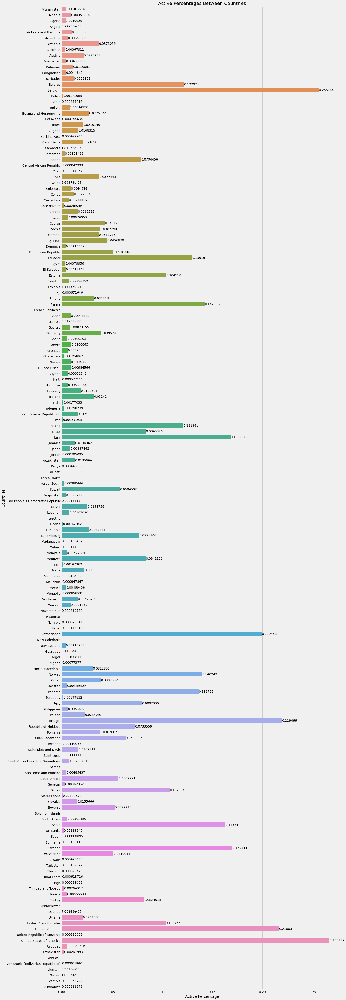

In [29]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Active', y = 'Country', data = fat_supply_quantity_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Active Percentages Between Countries"
plt.title(title)
plt.xlabel("Active Percentage")
plt.ylabel("Countries")
plt.show()

ALL Health Diet Fat Intakes Percentages Between Countries

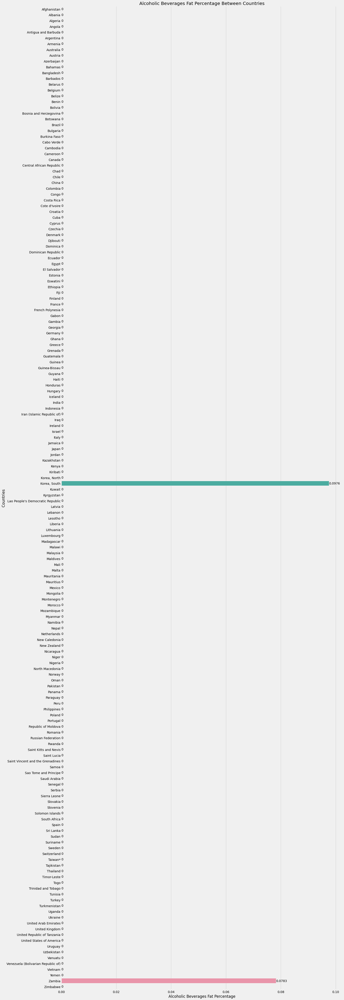

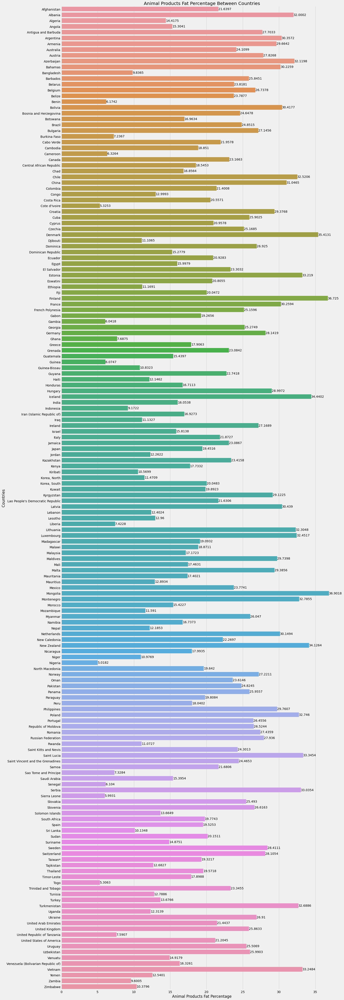

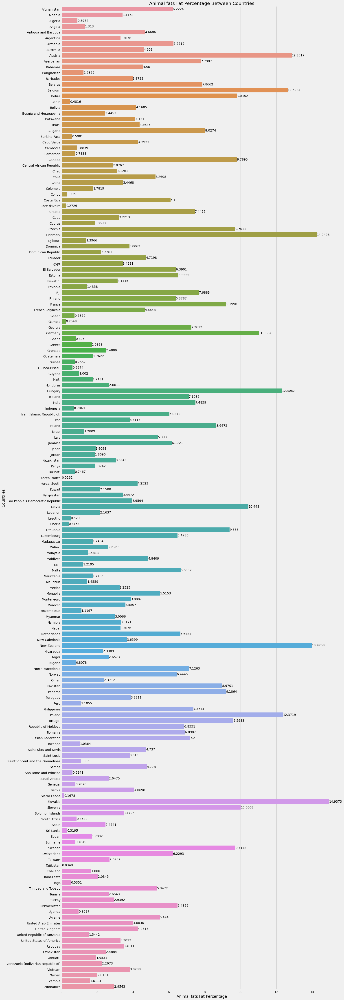

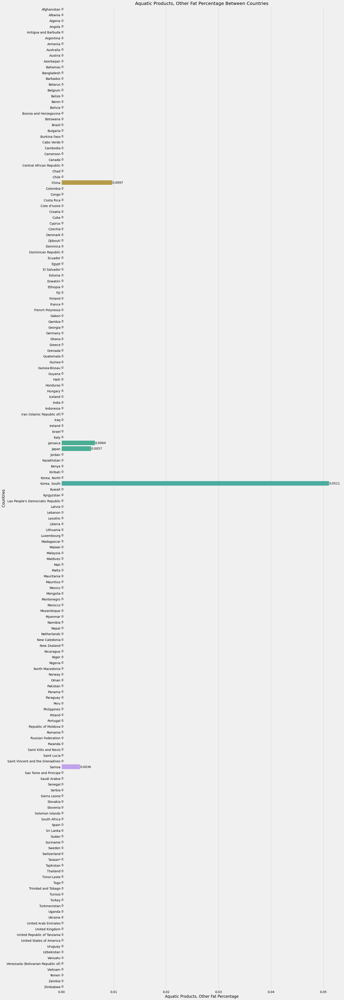

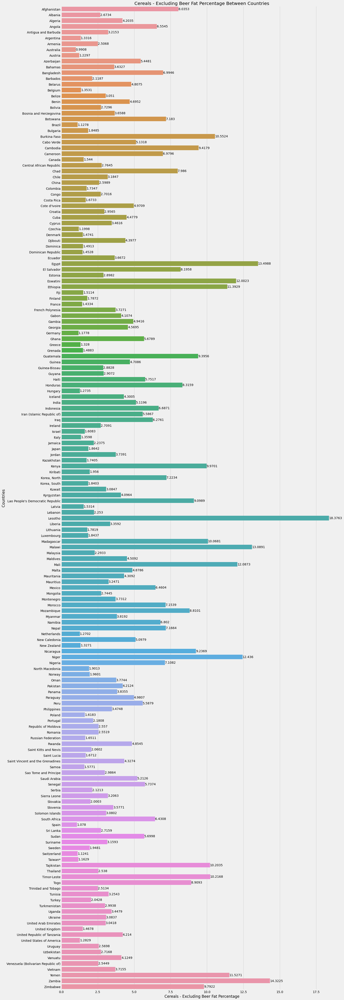

...

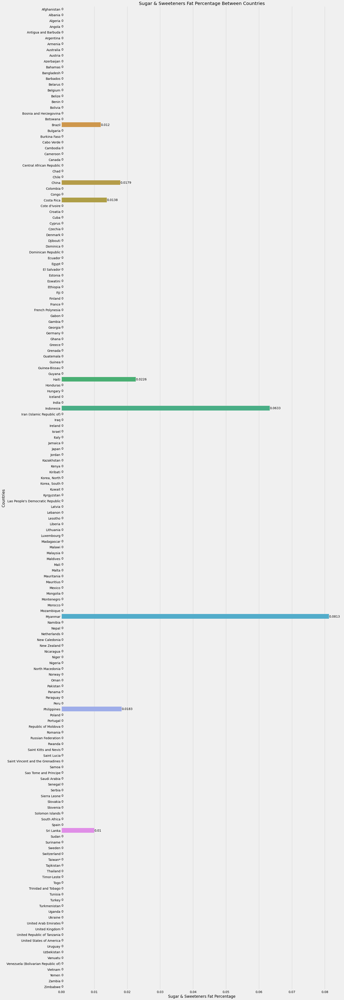

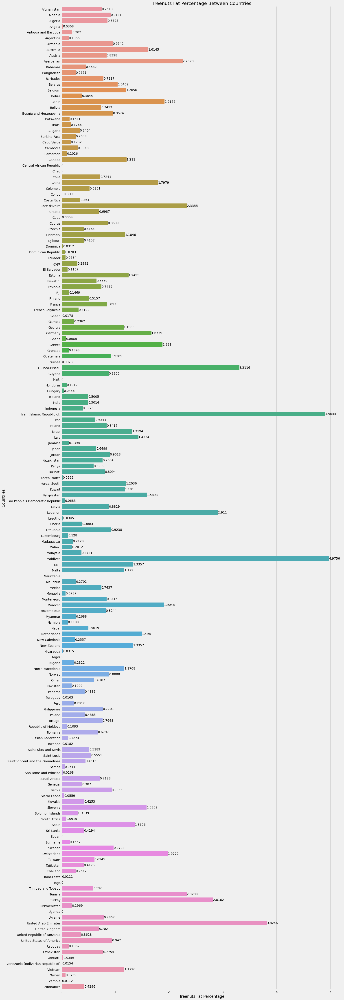

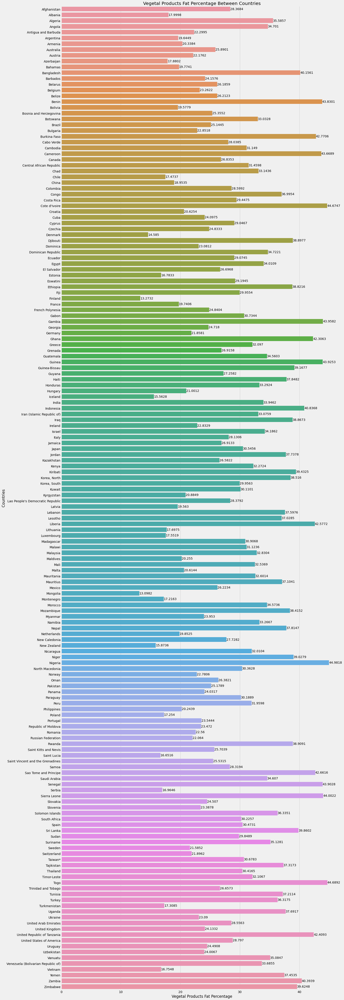

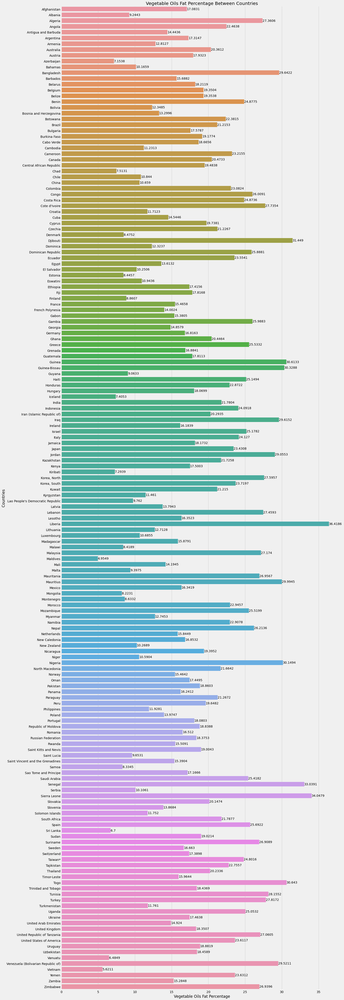

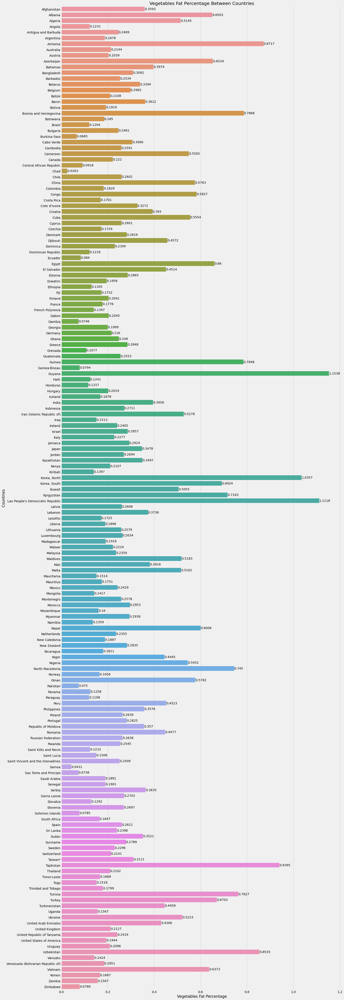

In [30]:
for intake in health_diet_intakes:
  fig, ax = plt.subplots(figsize=(20, 75))
  sns.barplot(x = intake, y = 'Country', data = fat_supply_quantity_data, capsize = 0.2, orient = 'h', ax = ax)
  ax.bar_label(ax.containers[-1], label_type='edge')
  style.use('fivethirtyeight')
  title = intake + " Fat Percentage Between Countries"
  x_title = intake + " Fat Percentage"
  y_title = "Countries"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  plt.show()
  print("          ")
  print("          ")